In [82]:
import numpy as np
import pandas as pd
import os
import fiona
import datetime
import rasterio as rio
from rasterio.plot import show
from rasterio.windows import from_bounds, transform
import matplotlib.pyplot as plt

# Plot Nolan 2021 terminus position data

In [83]:
# read in Nolan 2021 data
tpospath = '/Users/jukesliu/Documents/TURNER/DATA/Nolan2021/Terminus/Terminus_Position_Full_err.shp'
f = fiona.open(tpospath)

In [84]:
datetimes = []; imgnames = []; areas = []; errors = [] 
for tpos in f:
    # grab properties
    area = tpos['properties']['Area']
    error = tpos['properties']['Error']
    date = tpos['properties']['Date']
    imgname = tpos['properties']['Id']
    dateobj = datetime.datetime.strptime(date, '%Y%m%d') # create date object

    # append to lists
    if imgname == None:
        imgnames.append(np.NaN)
    else:
        imgnames.append(imgname)
    datetimes.append(dateobj); areas.append(area); errors.append(error)
    
tpos_df = pd.DataFrame(list(zip(datetimes, imgnames, areas, errors)),
                       columns=['datetime','image_name','area_km2','error_km2'])
tpos_df
    
    

ERROR 1: PROJ: proj_identify: Cannot find proj.db


,datetime,image_name,area_km2,error_km2
0,1980-06-24,NaN,5.90300,0.9360
1,1980-06-25,NaN,5.78800,0.9288
2,1980-07-22,NaN,5.74600,0.8784
3,1981-06-19,NaN,5.18500,0.9108
4,1981-09-01,NaN,5.05200,0.8568
...,...,...,...,...
437,2017-04-26,LE07_L1TP_061018_20170426_20170522_01_T1,6.11193,0.5922
438,2017-05-11,LC08_L1TP_062018_20170511_20170525_01_T1,6.36354,0.6048
439,2017-05-12,LE07_L1TP_061018_20170512_20170608_01_T1,6.37575,0.6111
440,2017-05-27,LC08_L1TP_062018_20170527_20170615_01_T1,6.59559,0.5994


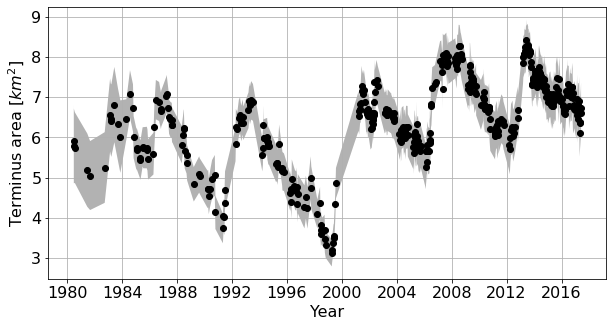

In [94]:
# Plot
fig, ax = plt.subplots(1, figsize=(10,5))
fs = 16
a = 0.3
plt.fill_between(tpos_df.datetime,tpos_df.area_km2-tpos_df.error_km2,
                 tpos_df.area_km2+tpos_df.error_km2, color='black',edgecolor=None,alpha=a) # plot
plt.plot(tpos_df.datetime,tpos_df.area_km2,color='black',marker='o',ls='none') # plot
plt.ylabel('Terminus area [$km^2$]', fontsize=fs)
plt.xlabel('Year',fontsize=fs)
plt.tick_params(labelsize=fs)
plt.grid()
plt.show()

# Plot new terminus position data over old dataset

In [66]:
newtpospath = '/Users/jukesliu/Documents/TURNER/DATA/shapefiles_gis/TERMINUS_POSITIONS/SK_term_pos.shp'
fnew = fiona.open(newtpospath)

In [67]:
datetimes = []; imgnames = []; areas = []; embayments = []; plumes = []
for newtpos in fnew:
    # grab properties
    area = newtpos['properties']['area_km2']
    imgname = newtpos['properties']['IMG_ID']
    embayment = newtpos['properties']['embayment']
    plume = newtpos['properties']['plume']
    
    # grab from imgname
    date = imgname.split('_')[3]
    dateobj = datetime.datetime.strptime(date, '%Y%m%d') # create date object

    # append to lists
    imgnames.append(imgname); datetimes.append(dateobj); areas.append(area)
    embayments.append(embayment); plumes.append(plume)
    
newtpos_df = pd.DataFrame(list(zip(datetimes, imgnames, areas, embayments, plumes)),
                       columns=['datetime','image_name','area_km2', 'embayment', 'plume'])
newtpos_df

ERROR 1: PROJ: proj_identify: Cannot find proj.db


,datetime,image_name,area_km2,embayment,plume
0,2013-12-03,LC08_L1TP_061018_20131203_20200912_02_T1,7.50185,0,0
1,2013-11-17,LC08_L1TP_061018_20131117_20200912_02_T1,7.51996,0,0
2,2013-09-30,LC08_L1TP_061018_20130930_20200912_02_T1,7.65099,0,0
3,2013-08-13,LC08_L1TP_061018_20130813_20200913_02_T1,8.25867,0,1
4,2013-07-28,LC08_L1TP_061018_20130728_20200912_02_T1,8.10047,0,1
...,...,...,...,...,...
127,2015-05-31,LC08_L1TP_061018_20150531_20200909_02_T1,6.50742,0,0
128,2015-05-15,LC08_L1TP_061018_20150515_20200909_02_T1,6.56605,0,0
129,2015-04-13,LC08_L1TP_061018_20150413_20200909_02_T1,6.64240,0,0
130,2015-03-28,LC08_L1TP_061018_20150328_20200909_02_T1,6.60974,0,0


In [96]:
newtpos_df = newtpos_df.sort_values(by='datetime')
newtpos_df.to_csv('/Users/jukesliu/Documents/TURNER/DATA/figures/terminus_positions_2013_2022.csv')

In [70]:
# newtpos_df[newtpos_df.datetime > datetime.datetime(2021,1,1)]

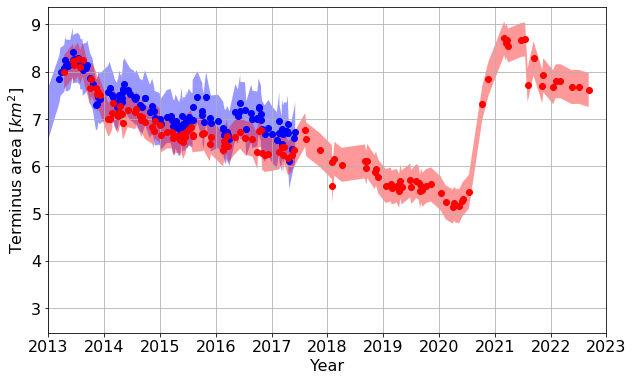

In [102]:
# # Plot
fig, ax = plt.subplots(1, figsize=(10,6))
fs = 16
a = 0.4

# grab the data points where the embayment or plume exists
feature_df = newtpos_df[newtpos_df.embayment == 1]
feature_df.head()
feature = 'Embayment'
jukes_err = 0.359 # RMSE

plt.fill_between(tpos_df.datetime,tpos_df.area_km2-tpos_df.error_km2,
                 tpos_df.area_km2+tpos_df.error_km2, color='blue',edgecolor=None,alpha=a) # plot
plt.plot(tpos_df.datetime,tpos_df.area_km2,color='blue',marker='o',ls='none') # plot

plt.fill_between(newtpos_df.datetime,newtpos_df.area_km2-jukes_err,
                 newtpos_df.area_km2+jukes_err, color='red',edgecolor=None,alpha=a) # plot
plt.plot(newtpos_df.datetime,newtpos_df.area_km2,color='red',marker='o',ls='none') # plot


# plt.errorbar(feature_df.datetime, feature_df.area_km2, 
#              yerr=np.ones(len(feature_df.area_km2))*jukes_err, 
#              marker='s', color='orange', ls='none', alpha=a+0.1) # overlap (feature)
plt.ylabel('Terminus area [$km^2$]', fontsize=fs)
plt.xlabel('Year',fontsize=fs)
plt.tick_params(labelsize=fs)
# plt.legend(["This study", feature+' present','Nolan et al. (2021) traces',], fontsize=fs-4)
# plt.legend(['Nolan et al. (2021)','Nolan et al. (2021)','This study'], loc='lower right',fontsize=fs)
plt.xlim(datetime.datetime(2013,1,1), datetime.datetime(2023,1,1))
plt.grid()
plt.show()

In [75]:
newtpos_df['error_km2'] = np.ones(len(newtpos_df.area_km2))*jukes_err

# Check traces

In [9]:
################################### Path to LS8 images ###################################
imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/BoxTurner/collection02/'
##########################################################################################
imgs = []; dates = []
for img in os.listdir(imgpath):
    imgs.append(img)
    dates.append(img.split('_')[3])
zipped = list(zip(imgs, dates)) # zipped list of image name, date
sorted_zipped = sorted(zipped, key = lambda x: x[1]) # sort by second column, date
sorted_imgs = list(zip(*sorted_zipped))[0] # sorted imagenames by date
sorted_imgs

('LC08_L1TP_062018_20130414_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20130610_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_20130617_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_20130703_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20130712_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_20130719_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20130728_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20130813_20200913_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_20130820_20200913_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20130829_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_20130905_20200913_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20130930_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_20131007_20200913_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20131016_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_061018_20131101_20200912_02_T1_B8_BufferTurner.TIF',
 'LC08_L1TP_062018_201311

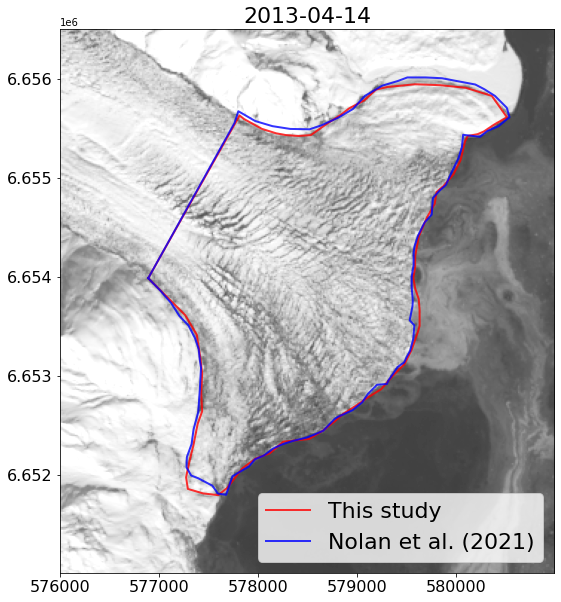

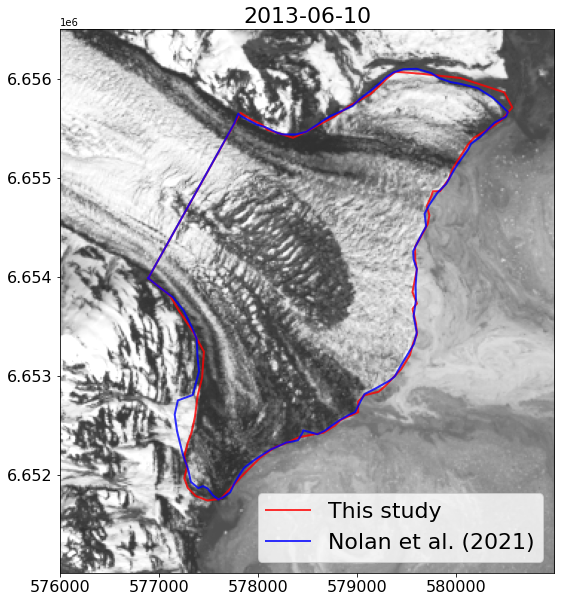

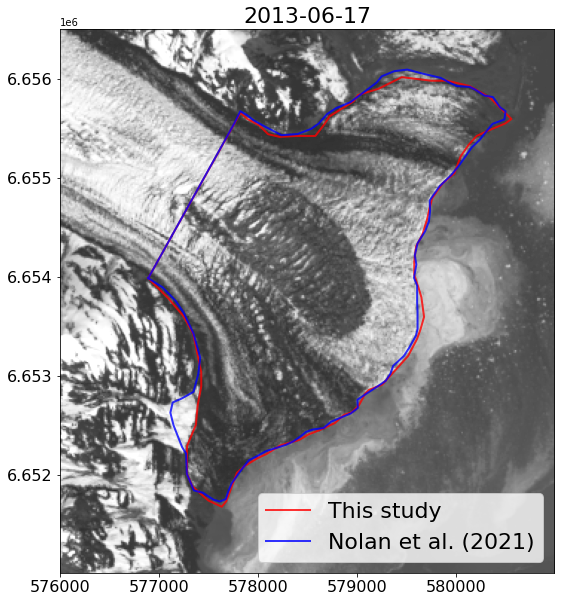

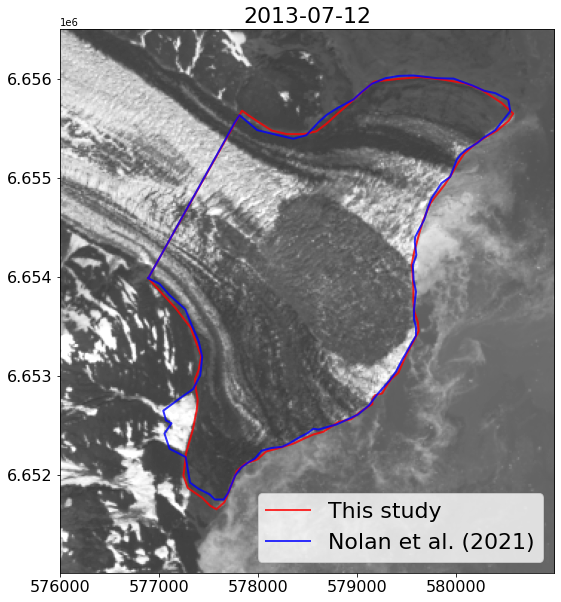

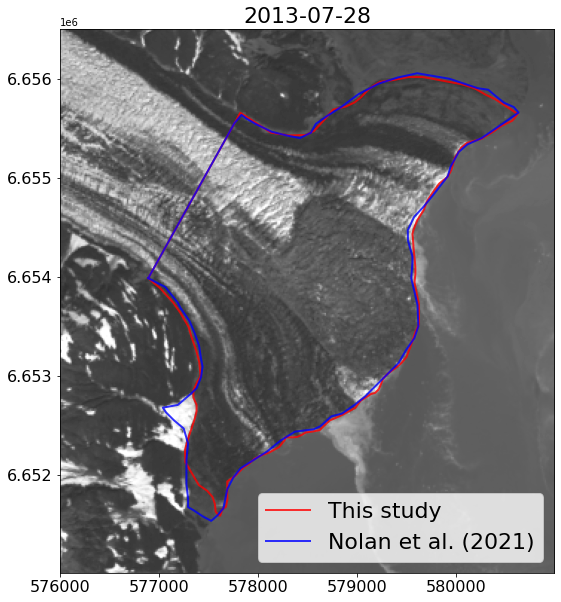

...

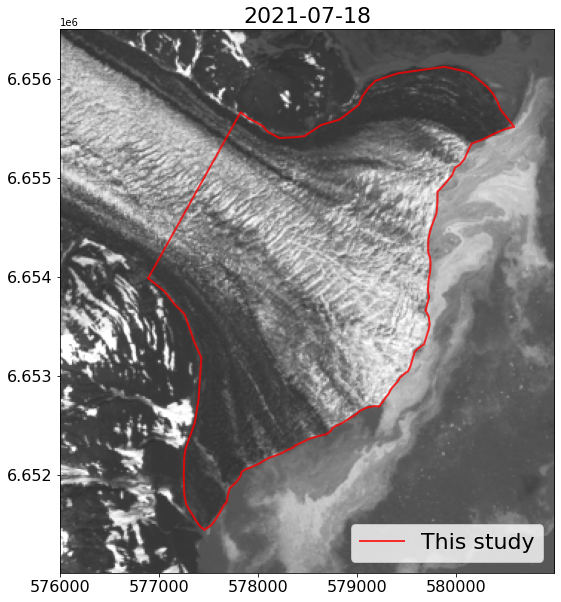

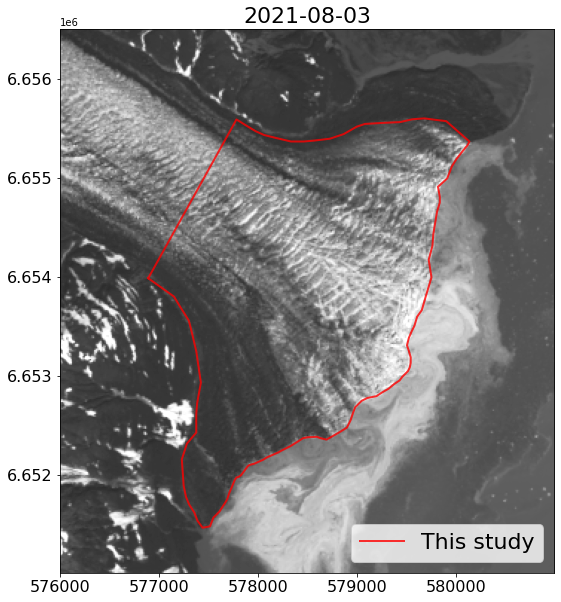

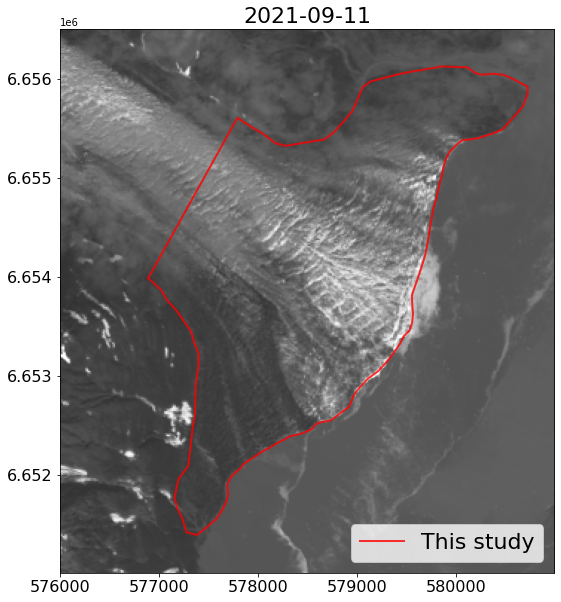

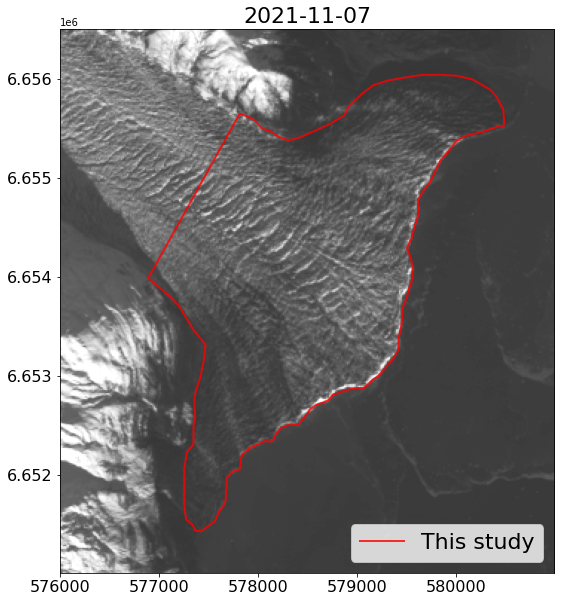

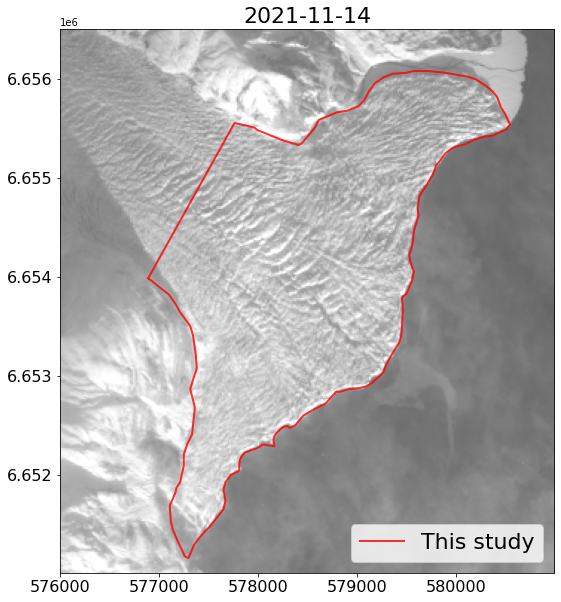

In [104]:
##### Set start and end date ############
start_date = datetime.datetime(2013,1,1)
end_date = datetime.datetime(2022,1,1)
lw = 2 # linewidth
a = 0.8 # alpha
# window bounds(UTM):
left = 576000
right = 581000
top = 6.6565e6
bottom = 6.651e6
################################################################

area_differences = []
for imgname in sorted_imgs:
    scene = imgname[:40]
    date = scene.split('_')[3]
    dateobj = datetime.datetime.strptime(date, '%Y%m%d')
    
    # work with only those that have new terminus positions associated with them and between date bounds
    if scene in list(newtpos_df.image_name) and dateobj >= start_date and dateobj <= end_date:
        fig, ax = plt.subplots(figsize=(10,10))
#         print(scene)

        # open and show satellite image subset using rasterio
        ds = rio.open(imgpath+imgname)
        window = from_bounds(left, bottom, right, top, ds.transform)
        show(ds.read(window=window), 
             transform = transform(window, ds.transform), # use window transform
             cmap = 'Greys_r',
             vmin=np.nanmin(ds.read(window=window))*.4, # contrast stretch
             vmax=np.nanmax(ds.read(window=window))*.8, # contrast stretch
             ax=ax)
        
        jfound = False; afound = False;
        # grab Jukes shapefile layer associated with the scene
        for layer in fnew:
            if layer['properties']['IMG_ID'] == scene:
                fcoords = layer['geometry']['coordinates'][0] # coordinates of shapefile
                j_area = layer['properties']['area_km2'] # area
                [x,y] = list(zip(*fcoords)) # split into x, y
                ax.plot(x,y,'-',color='red',linewidth=lw, alpha=a) # plot the 1st terminus trace
                jfound = True
                break # stop searching
                
        # grab Andrew's shapefile layer associated with the scene
        for layer in f:
            if layer['properties']['Date'] == date:
                fcoords = layer['geometry']['coordinates'][0] # coordinates of shapefile
                a_area = layer['properties']['Area'] # area
                [x,y] = list(zip(*fcoords)) # split into x, y
                ax.plot(x,y,'b-', linewidth=lw, alpha=a)# plot the terminus trace
                afound = True
                break # stop searching
                        
        ax.set_title(date[0:4]+'-'+date[4:6]+'-'+date[6:8], fontsize=fs+6)        
        ax.set_aspect('equal')
        ax.tick_params(labelsize=fs)
        plt.legend(['This study','Nolan et al. (2021)'], fontsize=fs+6, loc='lower right')
        plt.show()
        
        if jfound == True and afound == True: # if traces exist for both datasets on this date:
            area_differences.append(j_area - a_area) # store the difference
area_differences = np.array(area_differences)

In [56]:
np.count_nonzero(area_differences)

71

# Calculate inter-analyst error

In [62]:
RMSE = np.sqrt(np.nanmean((area_differences)**2))
print(RMSE)

0.35915137301426


In [63]:
mean = np.nanmean(area_differences)
print(mean)

-0.2860022535211267


In [59]:
st_dev = np.nanstd(area_differences)
print(st_dev)

0.21723816358749054


In [60]:
np.nanmax(area_differences)

0.34609000000000023

In [61]:
np.nanmin(area_differences)

-0.6949299999999994